<a href="https://colab.research.google.com/github/Fareeda84/Road_segmentation/blob/main/Road_segmentation_Keras.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Semantic segmentation to classify roads

This notebook describes about the modelling of binary segmentation to classify roads using Keras framework.


In [ ]:
pip install patchify

In [1]:
pip install imagecodecs

     |████████████████████████████████| 29.6 MB 74.6 MB/s 


In [3]:
# Importing libraries

import tensorflow as tf
from tensorflow.keras.utils import normalize
import os
import cv2

import numpy as np
from matplotlib import pyplot as plt

from keras.optimizers import Adam
import glob

from skimage.io import imread, imshow
from skimage.transform import resize

from patchify import patchify, unpatchify

import imagecodecs
import tifffile as tiff

from tensorflow.keras.metrics import MeanIoU

from keras.preprocessing import image

from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau

from keras.layers import Input, BatchNormalization, Activation, Dense, Dropout
from keras.layers.convolutional import Conv2D, Conv2DTranspose
from keras.layers.pooling import MaxPooling2D, GlobalMaxPool2D
from keras.layers.merge import concatenate, add
from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau

from keras.models import Model
import random

from sklearn.model_selection import train_test_split
import keras.backend as K





from sklearn.metrics import confusion_matrix, classification_report, f1_score, recall_score, accuracy_score, roc_auc_score

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# Training images 

There are 10 training images of size 4200*3200 with their masks.


In [4]:
# Reading images' path
image_names = glob.glob("/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train/Img/*.jpg")
print(image_names)

['/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train/Img/BX24_500_013030.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train/Img/BX24_500_013029.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train/Img/BX24_500_013027.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train/Img/BX24_500_013026.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train/Img/BX24_500_013028.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train/Img/BX24_500_013014.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train/Img/BX24_500_013025.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train/Img/BX24_500_013022.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train/Img/BX24_500_013023.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train/Img/BX24_500_013024.jpg']


In [5]:
# Sorting images' path
image_names.sort()
print(image_names)

['/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train/Img/BX24_500_013014.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train/Img/BX24_500_013022.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train/Img/BX24_500_013023.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train/Img/BX24_500_013024.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train/Img/BX24_500_013025.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train/Img/BX24_500_013026.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train/Img/BX24_500_013027.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train/Img/BX24_500_013028.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train/Img/BX24_500_013029.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train/Img/BX24_500_013030.jpg']


In [ ]:
len(image_names)

10

In [6]:
# Create a function for viewing training images 

def show_images(images):
  """
  Displays images from a data.
  """
  # Setup the figure
  plt.figure(figsize=(20, 20))
  # Loop through length of images (for displaying images)
  for i in range(len(image_names)):
    # Create subplots (3 rows, 4 columns)
    ax = plt.subplot(3, 4, i+1)
    # Display an image
    img = imread(images[i])
    plt.imshow(img)
  plt.show()
    
    # Turn gird lines off
  plt.axis("off")

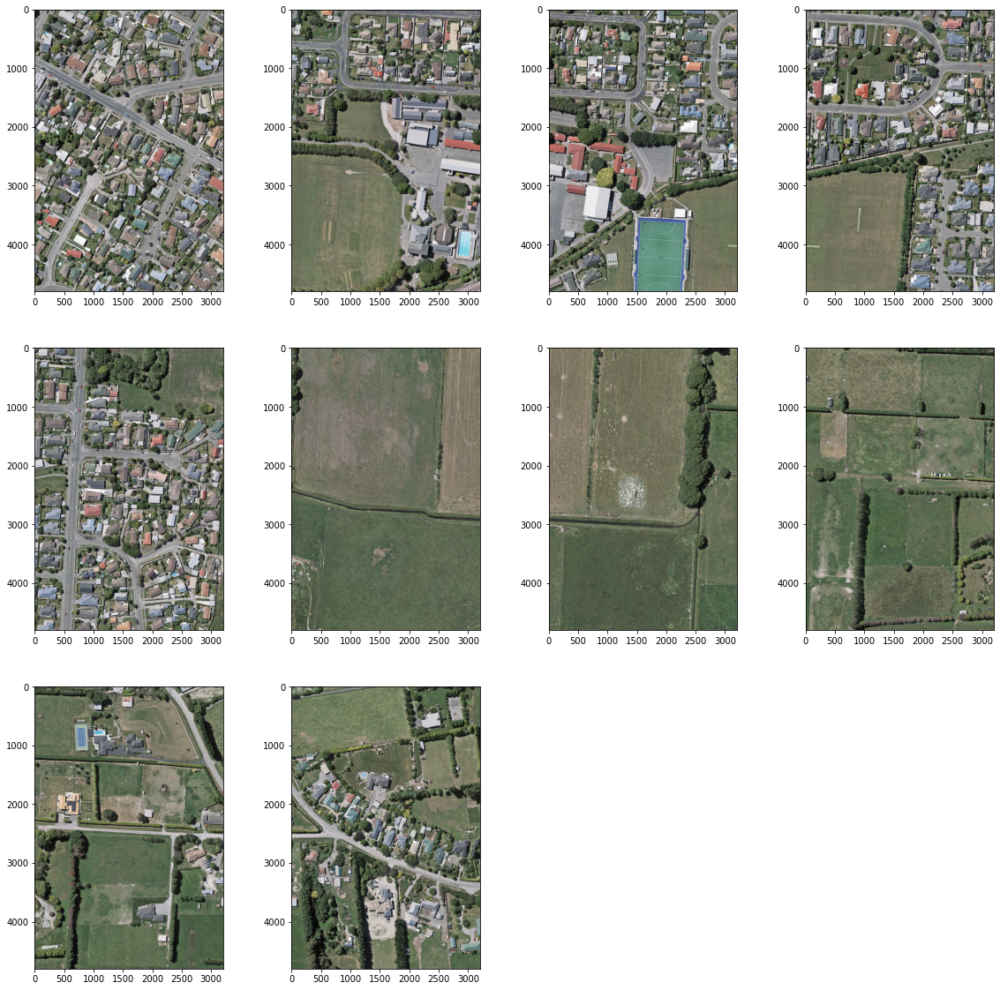

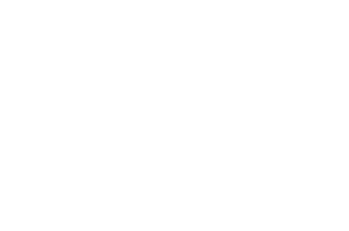

In [7]:
# To see the training images
show_images(image_names)

## Masks

In [8]:
# Reading masks path and sorting them
mask_names = glob.glob("/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train/Mask/*.tif")
mask_names.sort()

In [9]:
# Create a function for viewing masks 

def show_masks(images):
  """
  Displays masks from a data.
  """
  # Setup the figure
  plt.figure(figsize=(20, 20))
  # Loop through length of masks (for displaying masks)
  for i in range(len(mask_names)):
    # Create subplots (5 rows, 5 columns)
    ax = plt.subplot(3, 4, i+1)
    # Display an image
    img = imread(images[i])
    plt.imshow(img, cmap='gray')
  plt.show()
    
    # Turn gird lines off
  plt.axis("off")

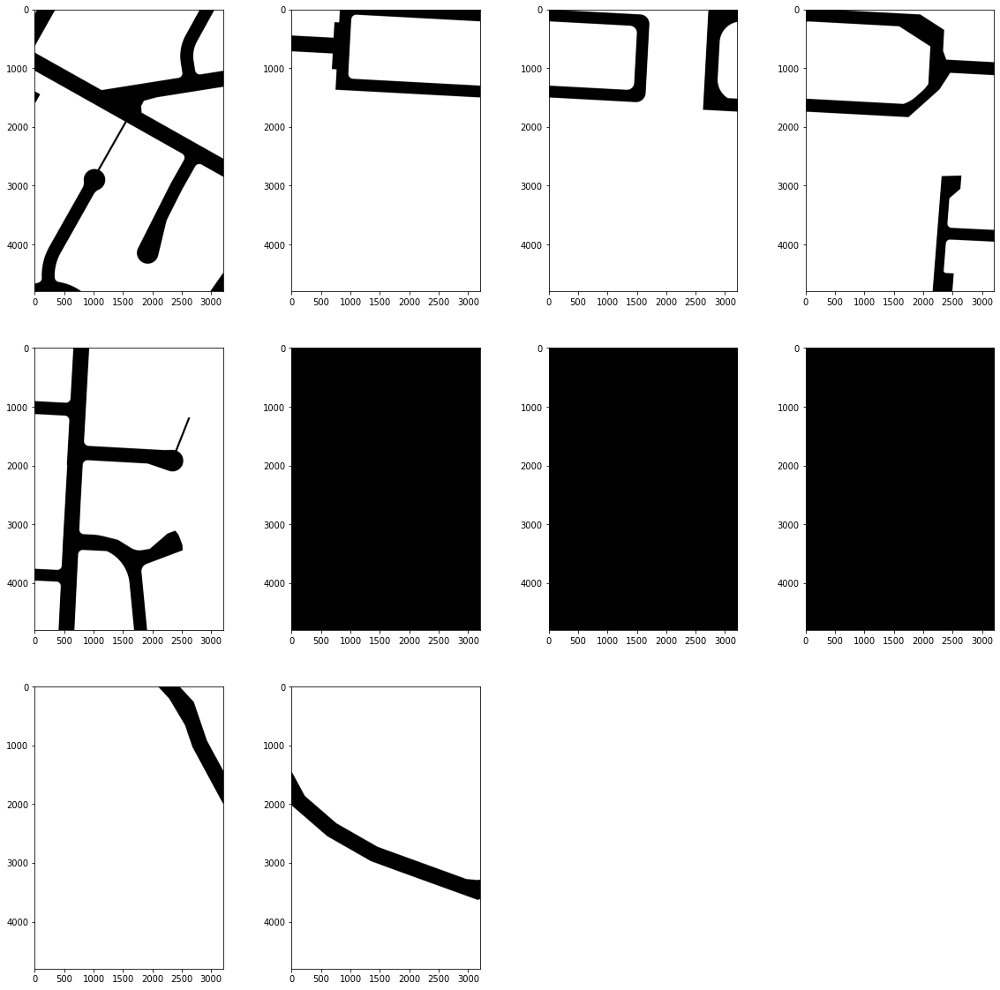

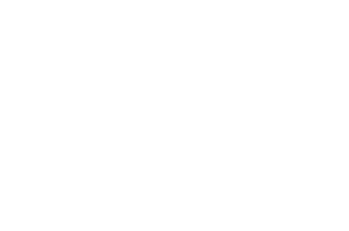

In [10]:
# To see the masks
show_masks(mask_names)

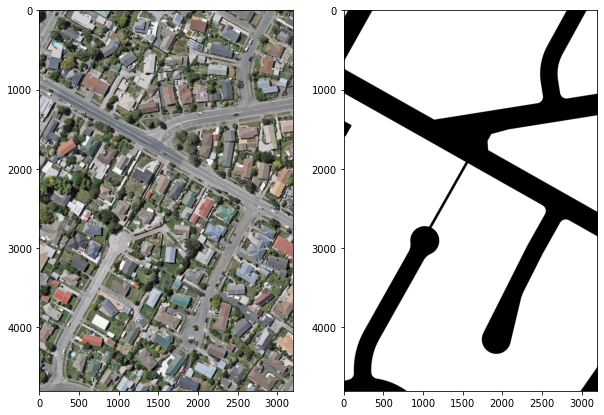

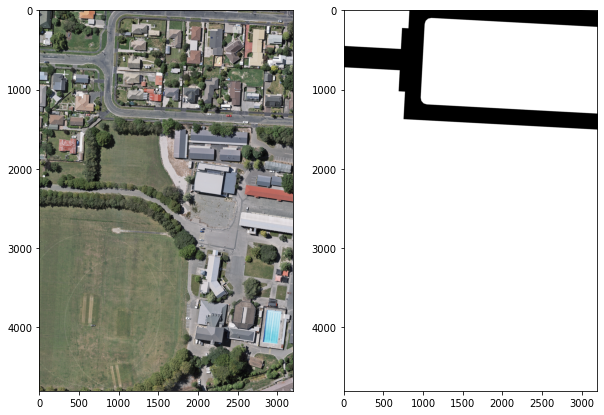

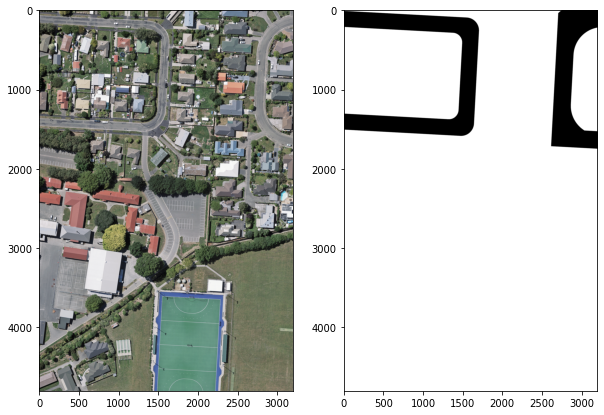

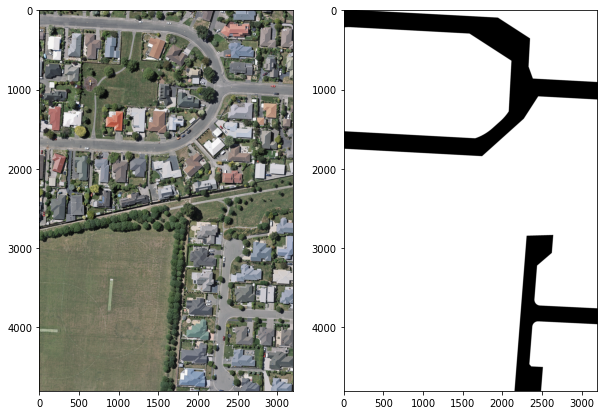

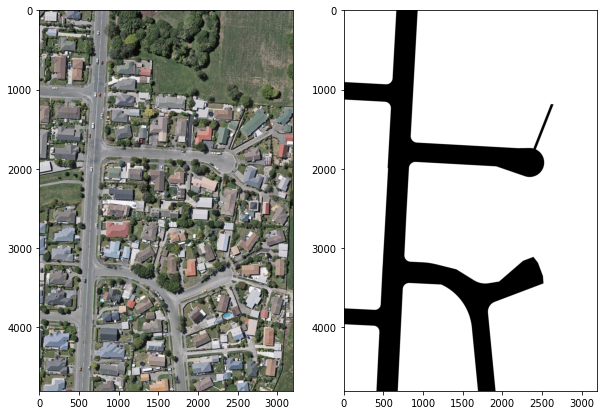

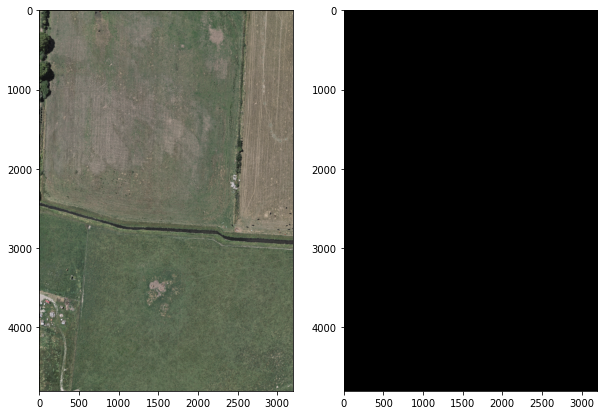

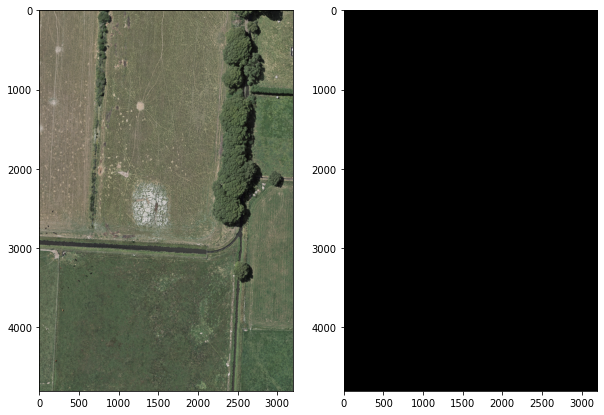

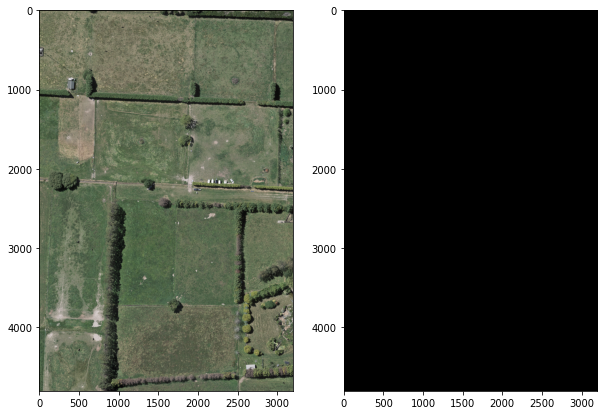

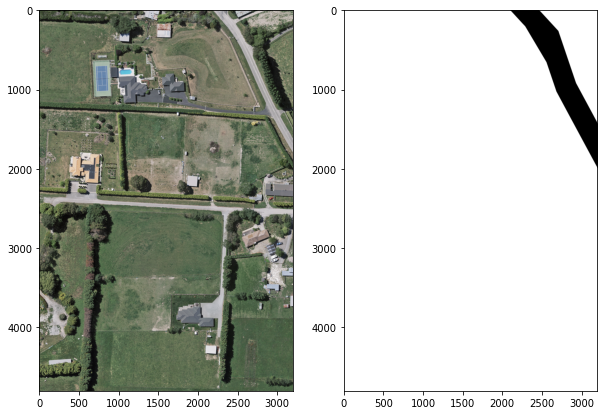

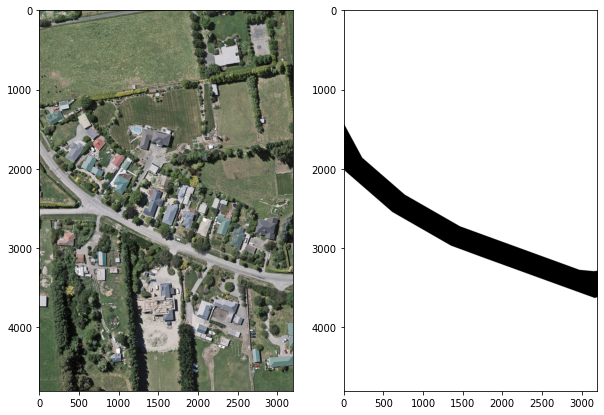

In [11]:
# To see images and their masks togather

for i in range(len(image_names)):
  plt.figure(figsize=(10, 10))
  plt.subplot(121)
  img = imread(image_names[i])
  plt.imshow(img)
  plt.subplot(122)
  mask = imread(mask_names[i])

  plt.imshow(mask, cmap='gray')

There is a bit of confusion here towards the masks labelling. If black lines are represented the roads on the images where roads are there then why there is a completely black mask for the image where there is no road?

Let us see the lables of the masks

In [ ]:
# Reading mask 8 
mask8 = imread(mask_names[8])

In [ ]:
# Number of unique lables in the mask 1 amd their counts

np.unique(mask8, return_counts=True)

(array([0, 1], dtype=int8), array([  543929, 14816071]))

Label 0 are 543929 which are less than label 1 14816071. Hence, black represents label 0 and white represents label 1.  

In [ ]:
# Reading image 5 which is complete balck
mask5 = imread(mask_names[5])

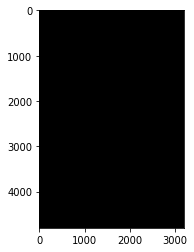

In [ ]:
plt.imshow(mask5, cmap='gray');

In [ ]:
np.unique(mask5, return_counts=True)

(array([1], dtype=int8), array([15360000]))

Changing label 1 to label 0 in the mask5

In [ ]:
for i in mask5:
  i[:] = 0
  

In [ ]:
np.unique(mask5, return_counts=True)

(array([0], dtype=int8), array([15360000]))

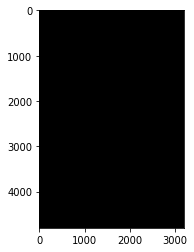

In [ ]:
plt.imshow(mask5, cmap='gray');

Mask is the whole balck, if either all labels 1 or all labels 0. 

 To avoid this confusion, I have decided to remove 3 images (images 4, 5 and 6) where there are no roads and their masks are complete balnk.

## Removing images and masks

In [12]:
# Deleting image 5,6 and 7 
del image_names[5:8]

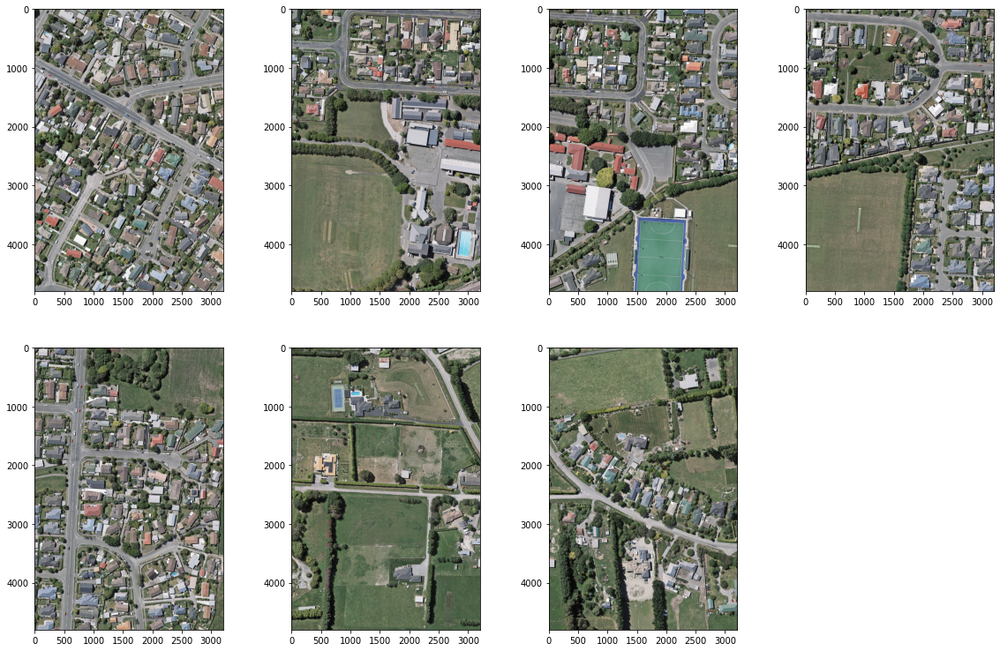

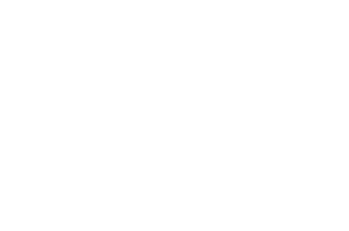

In [13]:
# Updated training images
show_images(image_names)

In [14]:
# Deleting mask 5, 6 and 7
del mask_names[5:8]

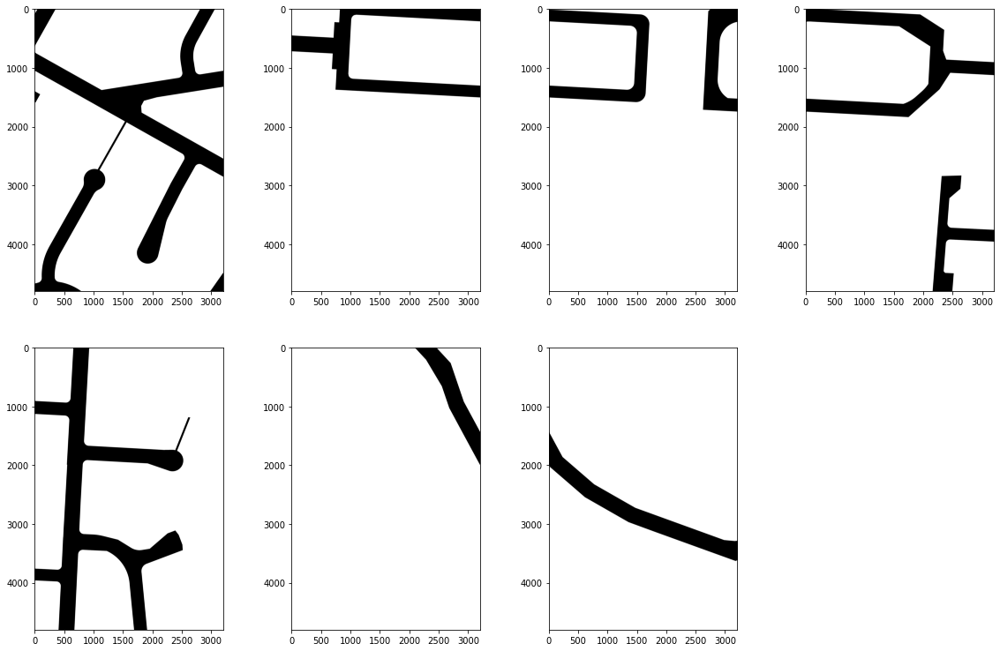

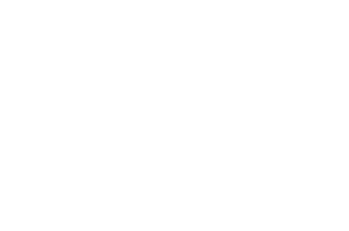

In [17]:
# To see updated masks
show_masks(mask_names)

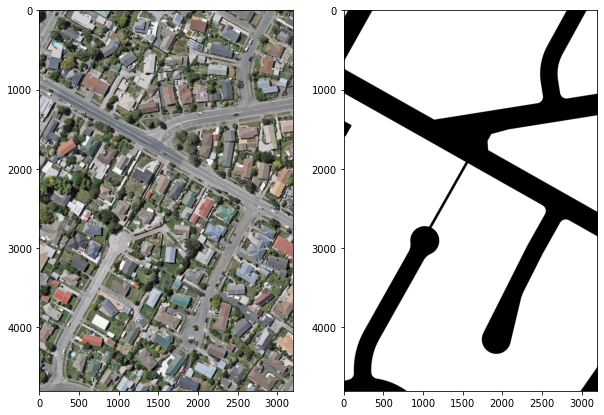

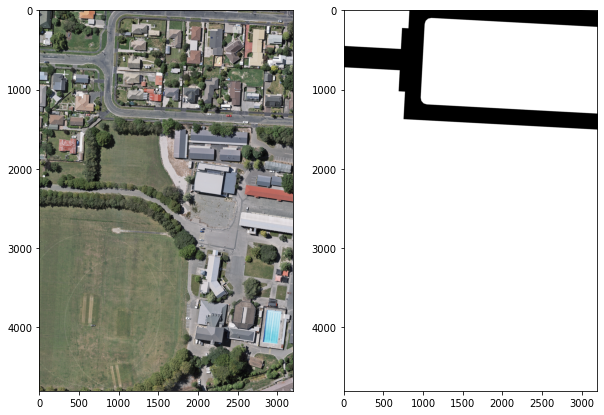

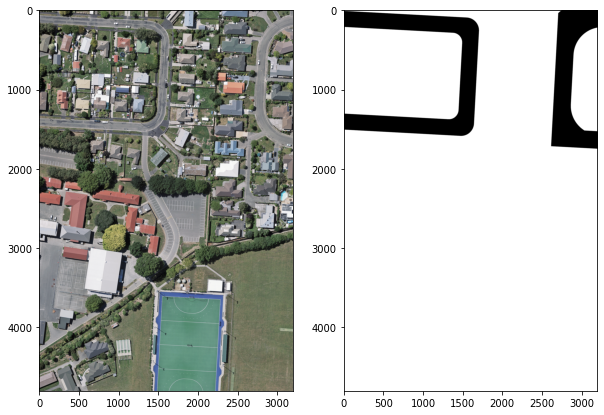

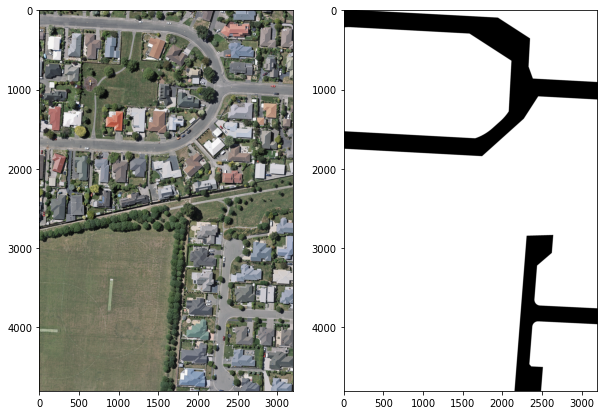

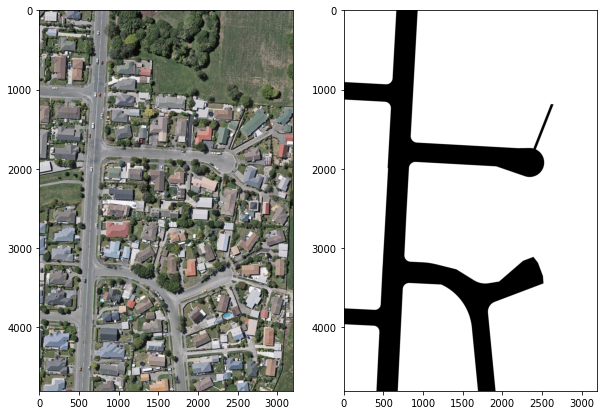

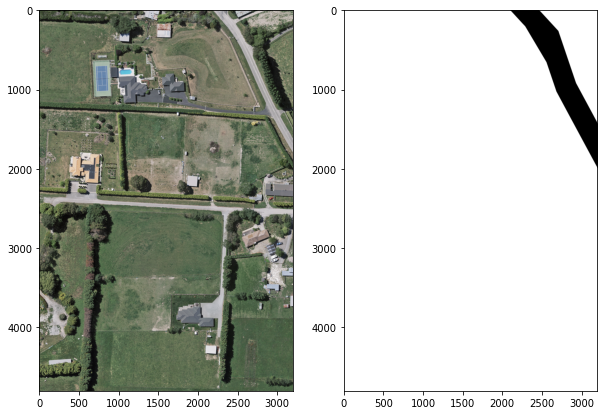

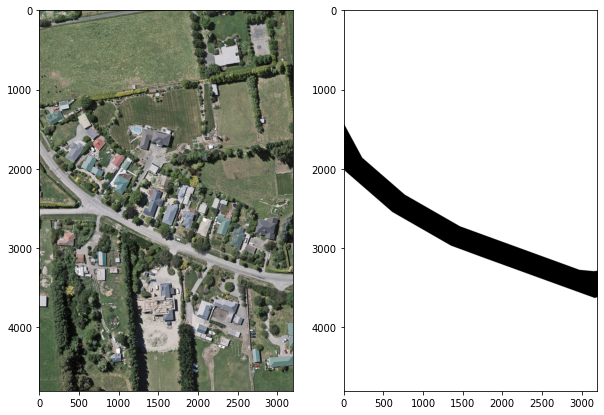

In [18]:
# To see updated images and their masks togather

for i in range(len(image_names)):
  plt.figure(figsize=(10, 10))
  plt.subplot(121)
  img = imread(image_names[i])
  plt.imshow(img)
  plt.subplot(122)
  mask = imread(mask_names[i])

  plt.imshow(mask, cmap='gray')

In [ ]:
# Reading training images and converting into numpy array

images = [cv2.imread(img, 3) for img in image_names]
image_dataset = np.array(images)
image_dataset.shape

(7, 4800, 3200, 3)

In [ ]:
# Reading masks and converting into numpy array

masks = [cv2.imread(mask, 0) for mask in mask_names]
mask_dataset = np.array(masks)
#mask_dataset = np.expand_dims(mask_dataset, axis = 3)

In [ ]:
mask_dataset.shape

(7, 4800, 3200)

Training images are of  4800 * 3200 sizes,
each training image is split into 150 tiles of 320 * 320 size using the Patchify library. Now, there are 1050 (150*7) tiles (images) in the training set. The same split for the masks as well. 


In [ ]:
# patchify library is used to split training images into 320*320 tiles and saving them 

for img in range(image_dataset.shape[0]):

  large_image = image_dataset[img]
  patches_img = patchify(large_image, (320, 320, 3), step=320)

  for i in range(patches_img.shape[0]):
    for j in range(patches_img.shape[1]):

      single_patch_img = patches_img[i,j,:,:]
      tiff.imwrite('/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train_patches/'+'img_'+str(img)+'_'+str(i)+str(j)+'.tif', single_patch_img)




Masks split into 1050 tiles of size 320 * 320

In [ ]:
# Splitting masks into 320*320 tiles and saving them

for img in range(mask_dataset.shape[0]):

  large_mask = mask_dataset[img]
  patches_mask = patchify(large_mask, (320, 320), step=320)

  for i in range(patches_mask.shape[0]):
    for j in range(patches_mask.shape[1]):

      single_patch_mask = patches_mask[i,j,:,:]
      tiff.imwrite('/content/drive/MyDrive/DataScience_Test_Road_Segementation/mask_patches/patches'+'img_'+str(img)+'_'+str(i)+str(j)+'.tif', single_patch_mask)




## Resize images

In [19]:
# Reading path of training resize images (tiles)

resize_image_names = glob.glob("/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train_patches_remove/train_patches/*.tif")
print(resize_image_names)

['/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train_patches_remove/train_patches/img_0_50.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train_patches_remove/train_patches/img_0_51.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train_patches_remove/train_patches/img_0_52.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train_patches_remove/train_patches/img_0_53.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train_patches_remove/train_patches/img_0_54.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train_patches_remove/train_patches/img_0_55.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train_patches_remove/train_patches/img_0_56.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train_patches_remove/train_patches/img_0_57.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train_patches_remove/train_patches/img_0_58.tif', '/content

In [20]:
# Sorting resize images
resize_image_names.sort()
print(resize_image_names)

['/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train_patches_remove/train_patches/img_0_00.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train_patches_remove/train_patches/img_0_01.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train_patches_remove/train_patches/img_0_02.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train_patches_remove/train_patches/img_0_03.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train_patches_remove/train_patches/img_0_04.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train_patches_remove/train_patches/img_0_05.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train_patches_remove/train_patches/img_0_06.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train_patches_remove/train_patches/img_0_07.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Train_patches_remove/train_patches/img_0_08.tif', '/content

In [51]:
# Reading resize images
resize_images = [cv2.imread(img, 3) for img in resize_image_names]


In [53]:
# Converting images into numpy array
resize_image_dataset = np.array(resize_images)
resize_image_dataset.shape

(1050, 320, 320, 3)

In [ ]:
resize_image_dataset[0].shape

(320, 320, 3)

In [22]:
# Create a function for viewing images first 25 resize images
def show_25_images(images):
  """
  Displays 25 images from a data batch.
  """
  # Setup the figure
  plt.figure(figsize=(20, 20))
  # Loop through 25 (for displaying 25 images)
  for i in range(25):
    # Create subplots (5 rows, 5 columns)
    ax = plt.subplot(5, 5, i+1)
    # Display an image
    img = images[i]
    plt.imshow(img)
  plt.show()
    
    # Turn gird lines off
  plt.axis("off")

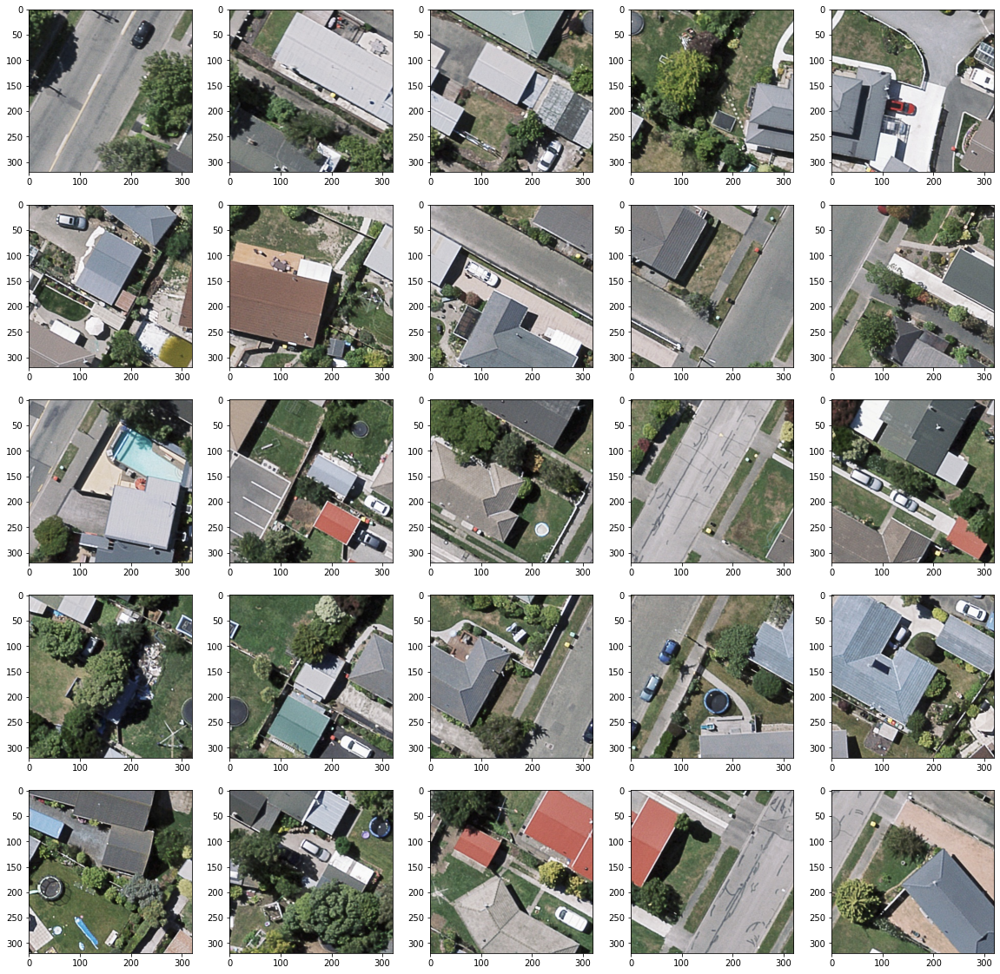

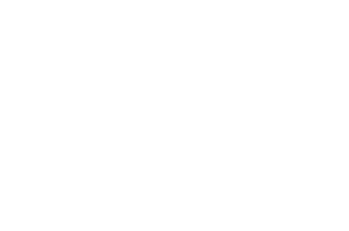

In [25]:
# To see first 25 resize images
show_25_images(resize_image_dataset)

## Mask resize

In [26]:
# Reading resize masks path
resize_mask_names = glob.glob("/content/drive/MyDrive/DataScience_Test_Road_Segementation/Masks_patches_remove/mask_patches/*.tif")
print(resize_mask_names)

['/content/drive/MyDrive/DataScience_Test_Road_Segementation/Masks_patches_remove/mask_patches/img_0_50.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Masks_patches_remove/mask_patches/img_0_51.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Masks_patches_remove/mask_patches/img_0_52.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Masks_patches_remove/mask_patches/img_0_53.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Masks_patches_remove/mask_patches/img_0_54.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Masks_patches_remove/mask_patches/img_0_55.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Masks_patches_remove/mask_patches/img_0_56.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Masks_patches_remove/mask_patches/img_0_57.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Masks_patches_remove/mask_patches/img_0_58.tif', '/content/drive/My

In [27]:
# Sorting resize masks path
resize_mask_names.sort()
print(resize_mask_names)

['/content/drive/MyDrive/DataScience_Test_Road_Segementation/Masks_patches_remove/mask_patches/img_0_00.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Masks_patches_remove/mask_patches/img_0_01.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Masks_patches_remove/mask_patches/img_0_02.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Masks_patches_remove/mask_patches/img_0_03.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Masks_patches_remove/mask_patches/img_0_04.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Masks_patches_remove/mask_patches/img_0_05.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Masks_patches_remove/mask_patches/img_0_06.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Masks_patches_remove/mask_patches/img_0_07.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Masks_patches_remove/mask_patches/img_0_08.tif', '/content/drive/My

In [52]:
# Reading resize  masks 
resize_mask = [cv2.imread(img, 0) for img in resize_mask_names]


In [54]:
# Convering masks intp numpy array
resize_mask_dataset = np.array(resize_mask)
resize_mask_dataset.shape

(1050, 320, 320)

In [30]:
# Create a function for viewing resize masks
def show_25_masks(images):
  """
  Displays 25 masks from a data batch.
  """
  # Setup the figure
  plt.figure(figsize=(20, 20))
  # Loop through 25 (for displaying 25 images)
  for i in range(25):
    # Create subplots (5 rows, 5 columns)
    ax = plt.subplot(5, 5, i+1)
    # Display an image
    img = images[i]
    plt.imshow(img, cmap='gray')
  plt.show()
    
    # Turn gird lines off
  plt.axis("off")

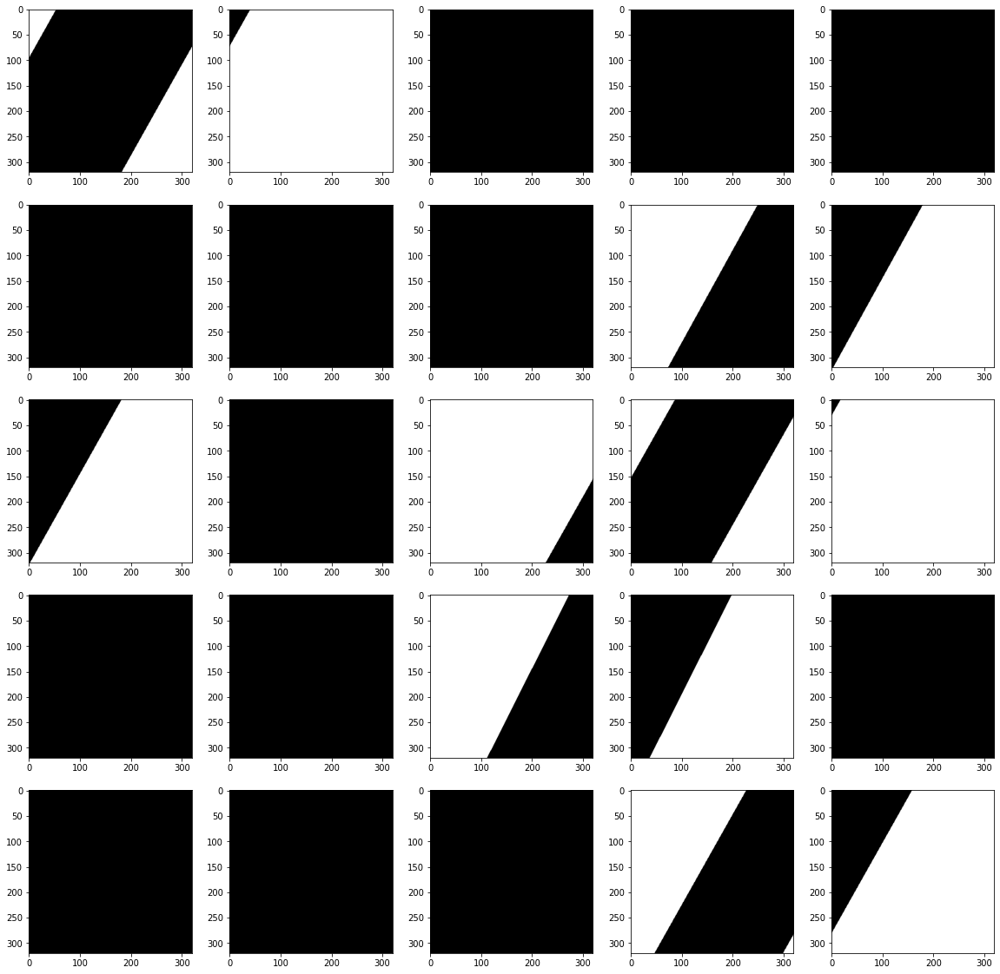

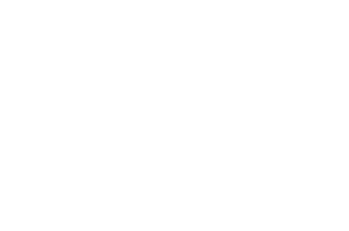

In [31]:
# To see first 25 resize images
show_25_masks(resize_mask_dataset)

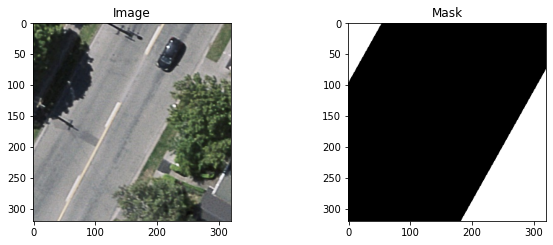

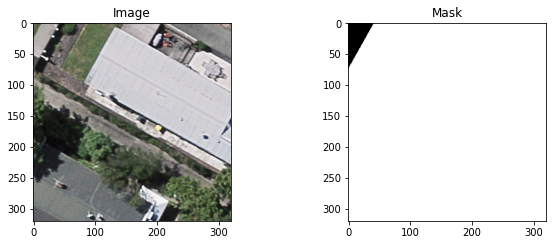

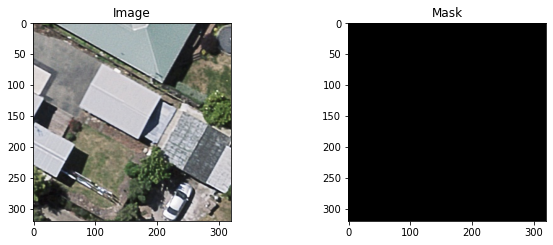

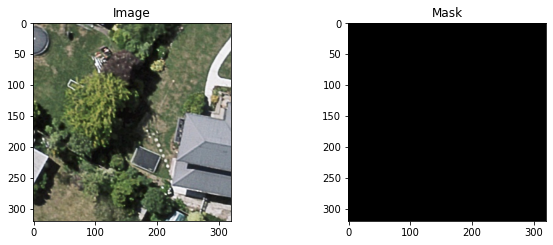

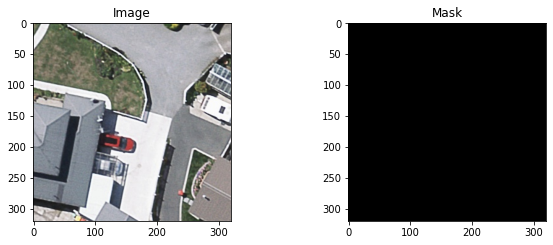

...

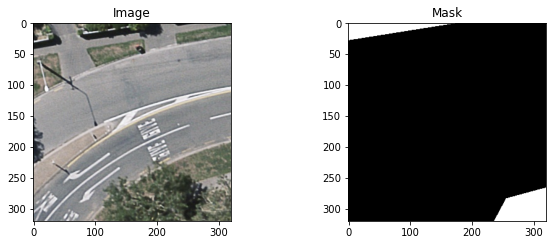

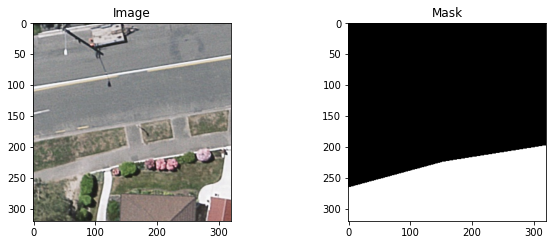

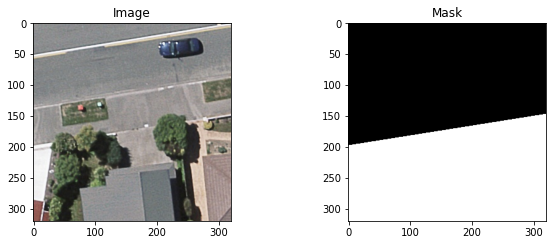

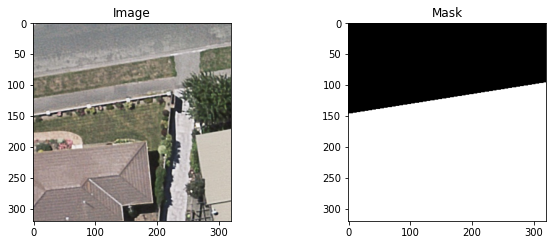

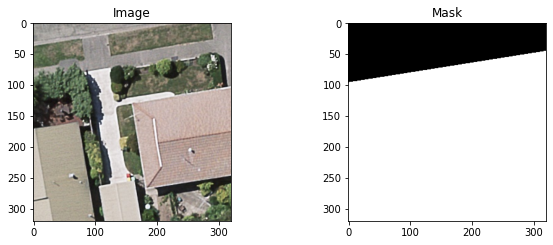

IndexError: ignored

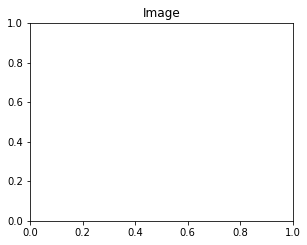

In [ ]:
# Viewing resize images and their masks togather

for i in range(len(resize_image_dataset[20])):
   

    plt.figure(figsize=(16, 8))
    plt.subplot(231)
    plt.title('Image')
    plt.imshow(resize_image_dataset[i])

    plt.subplot(232)
    plt.title('Mask')
    plt.imshow(resize_mask_dataset[i], cmap='gray')

    plt.show()    

In [55]:
# Converting masks into 4 dimentions 
resize_mask = np.expand_dims(resize_mask_dataset, axis = 3)
resize_mask.shape

(1050, 320, 320, 1)

In [ ]:
print("Image data shape is: ", resize_image_dataset.shape)
print("Mask data shape is: ", resize_mask.shape)
print("Max pixel value in image is: ", resize_image_dataset.max())
print("Labels in the mask are : ", np.unique(resize_mask))

Image data shape is:  (1050, 320, 320, 3)
Mask data shape is:  (1050, 320, 320, 1)
Max pixel value in image is:  255
Labels in the mask are :  [0 1]


In [56]:
#Normalize images
image_dataset_norm = resize_image_dataset /255.  


In [57]:
# Splitting into training (80%) and validation (20%) sets

X_train, X_valid, y_train, y_valid = train_test_split(image_dataset_norm, resize_mask, test_size = 0.20, random_state = 42)


In [ ]:
# To see the shapes of X_train, y_train, X_valid, y_valid
X_train.shape, y_train.shape, X_valid.shape, y_valid.shape

((840, 320, 320, 3),
 (840, 320, 320, 1),
 (210, 320, 320, 3),
 (210, 320, 320, 1))

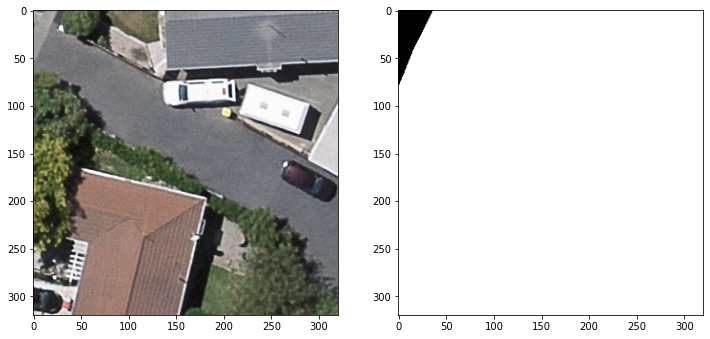

In [37]:
#Sanity check, view few mages
import random

image_number = random.randint(0, len(X_train)-1)
plt.figure(figsize=(12, 6))
plt.subplot(121)
plt.imshow(X_train[image_number,:,:])
plt.subplot(122)
plt.imshow(y_train[image_number,:,:,0], cmap='gray')
plt.show()

# Test images

In [38]:
# Reading test images path
test_names = glob.glob("/content/drive/MyDrive/DataScience_Test_Road_Segementation/Test/Img/*.jpg")
print(test_names)

['/content/drive/MyDrive/DataScience_Test_Road_Segementation/Test/Img/BQ32_5000_0201.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Test/Img/BX24_500_013017.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Test/Img/BQ32_5000_0301.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Test/Img/BX24_500_013036.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Test/Img/BX24_500_013013.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Test/Img/BX24_500_013016.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Test/Img/BX24_500_013012.jpg', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Test/Img/BX24_500_013015.jpg']


In [39]:
# Create a function for viewing images in the test set

def show_test(images):
  """
  Displays images from a data.
  """
  # Setup the figure
  plt.figure(figsize=(20, 20))
  # Loop through length of test (for displaying images)
  for i in range(len(test_names)):
    # Create subplots (3 rows, 4 columns)
    ax = plt.subplot(3, 4, i+1)
    # Display an image
    img = imread(images[i])
    plt.imshow(img)
  plt.show()
    
    # Turn gird lines off
  plt.axis("off")

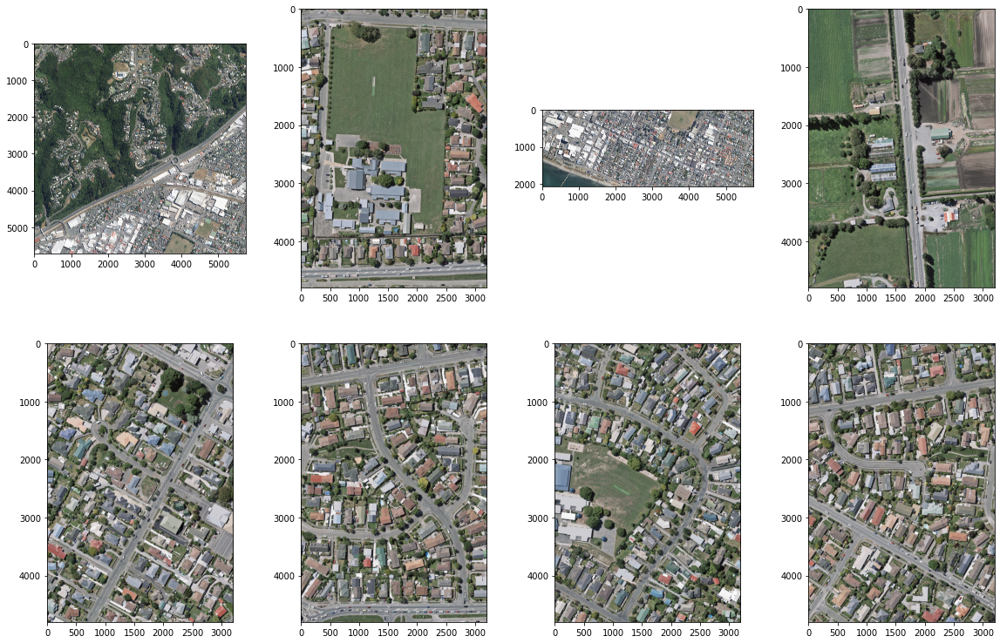

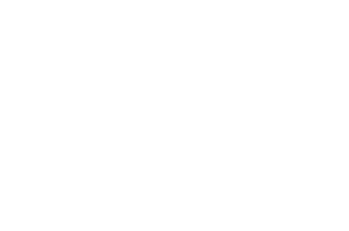

In [40]:
# To see test images
show_test(test_names)

Test images are of different sizes. So, converting all test images into 320*320 size.

In [41]:
# Defining height, width and colour channel

IMG_HEIGHT = 320
IMG_WIDTH = 320
IMG_CHANNELS = 3

In [42]:
# Create empty arrays

test = np.zeros((len(test_names), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS), dtype=np.uint8)



In [ ]:
test.shape

(8, 320, 320, 3)

In [43]:
# Loop to resize test inages into 320*320 size


for i, image_id in enumerate(test_names):
    
    
    
    # read the image using skimage
    image = imread(image_id)
    
    # resize the image
    image = resize(image, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
    
    # use np.expand dims to add a channel axis so the shape becomes (IMG_HEIGHT, IMG_WIDTH, 1)
    #image = np.expand_dims(image, axis=-1)
    
    # insert the image into X_train
    test[i] = image
    
test.shape

(8, 320, 320, 3)

In [45]:
# Normalise test image
X_test = test/255

In [ ]:
X_test.shape

(8, 320, 320, 3)

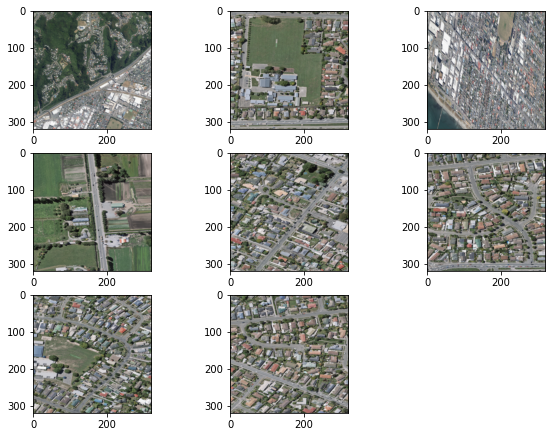

In [46]:
# To see resize test images

fig = plt.figure(figsize=(10, 10))
for i in range(len( X_test)):
  #img = image_name[i]
  fig.add_subplot(4, 3, i+1)
  plt.imshow(X_test[i])
plt.show()  

## Resize test

Test images of 4800 * 3200 sizes are split into 320 * 320 size tiles.

In [47]:
# Reading masks and converting into numpy array

tests = [cv2.imread(test, 3) for test in test_names]
test_dataset = np.array(tests)
#mask_dataset = np.expand_dims(mask_dataset, axis = 3)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  after removing the cwd from sys.path.


In [48]:
# Reading test image 3
test_1 = imread(test_names[3])
test_1_dataset = np.array(test_1)
test_1_dataset.shape

(4800, 3200, 3)

In [ ]:
# Splitting test into 320*320 tiles and saving them

#for img in range(mask_dataset.shape[0]):

large_test = test_1_dataset
patches_test = patchify(large_test, (320, 320, 3), step=320)

for i in range(patches_test.shape[0]):
  for j in range(patches_test.shape[1]):

    single_patch_test = patches_test[i,j,:,:]
    tiff.imwrite('/content/drive/MyDrive/DataScience_Test_Road_Segementation/Test/test_patches/patches/'+'img_'+str(i)+str(j)+'.tif', single_patch_test)

In [49]:
# Reading path of resize test images (tiles)
resize_test_names = glob.glob('/content/drive/MyDrive/DataScience_Test_Road_Segementation/Test/test_patches/patches/*.tif')
print(resize_test_names)

['/content/drive/MyDrive/DataScience_Test_Road_Segementation/Test/test_patches/patches/img_00.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Test/test_patches/patches/img_01.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Test/test_patches/patches/img_02.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Test/test_patches/patches/img_03.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Test/test_patches/patches/img_04.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Test/test_patches/patches/img_05.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Test/test_patches/patches/img_06.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Test/test_patches/patches/img_07.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Test/test_patches/patches/img_08.tif', '/content/drive/MyDrive/DataScience_Test_Road_Segementation/Test/test_patches/patches/img_09.tif', '/content

In [50]:
# Reading resize images
resize_test = [cv2.imread(img, 3) for img in resize_test_names]


In [ ]:
# Converting images into numpy array
resize_test_dataset = np.array(resize_test)
resize_test_dataset.shape

(150, 320, 320, 3)

In [ ]:
# Normalizing reszie test images
resize_test_norm = resize_test_dataset/255

In [ ]:
resize_test_norm.shape

(150, 320, 320, 3)

# Unet model

In [59]:
# U-net code

def conv2d_block(input_tensor, n_filters, kernel_size = 3, batchnorm = True):
    """Function to add 2 convolutional layers with the parameters passed to it"""
    # first layer
    x = Conv2D(filters = n_filters, kernel_size = (kernel_size, kernel_size),\
              kernel_initializer = 'he_normal', padding = 'same')(input_tensor)
    if batchnorm:
        x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    # second layer
    x = Conv2D(filters = n_filters, kernel_size = (kernel_size, kernel_size),\
              kernel_initializer = 'he_normal', padding = 'same')(input_tensor)
    if batchnorm:
        x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    return x
  
def get_unet(input_img, n_filters = 16, dropout = 0.1, batchnorm = True):
    # Contracting Path
    c1 = conv2d_block(input_img, n_filters * 1, kernel_size = 3, batchnorm = batchnorm)
    p1 = MaxPooling2D((2, 2))(c1)
    p1 = Dropout(dropout)(p1)
    
    c2 = conv2d_block(p1, n_filters * 2, kernel_size = 3, batchnorm = batchnorm)
    p2 = MaxPooling2D((2, 2))(c2)
    p2 = Dropout(dropout)(p2)
    
    c3 = conv2d_block(p2, n_filters * 4, kernel_size = 3, batchnorm = batchnorm)
    p3 = MaxPooling2D((2, 2))(c3)
    p3 = Dropout(dropout)(p3)
    
    c4 = conv2d_block(p3, n_filters * 8, kernel_size = 3, batchnorm = batchnorm)
    p4 = MaxPooling2D((2, 2))(c4)
    p4 = Dropout(dropout)(p4)
    
    c5 = conv2d_block(p4, n_filters = n_filters * 16, kernel_size = 3, batchnorm = batchnorm)
    
    # Expansive Path
    u6 = Conv2DTranspose(n_filters * 8, (3, 3), strides = (2, 2), padding = 'same')(c5)
    u6 = concatenate([u6, c4])
    u6 = Dropout(dropout)(u6)
    c6 = conv2d_block(u6, n_filters * 8, kernel_size = 3, batchnorm = batchnorm)
    
    u7 = Conv2DTranspose(n_filters * 4, (3, 3), strides = (2, 2), padding = 'same')(c6)
    u7 = concatenate([u7, c3])
    u7 = Dropout(dropout)(u7)
    c7 = conv2d_block(u7, n_filters * 4, kernel_size = 3, batchnorm = batchnorm)
    
    u8 = Conv2DTranspose(n_filters * 2, (3, 3), strides = (2, 2), padding = 'same')(c7)
    u8 = concatenate([u8, c2])
    u8 = Dropout(dropout)(u8)
    c8 = conv2d_block(u8, n_filters * 2, kernel_size = 3, batchnorm = batchnorm)
    
    u9 = Conv2DTranspose(n_filters * 1, (3, 3), strides = (2, 2), padding = 'same')(c8)
    u9 = concatenate([u9, c1])
    u9 = Dropout(dropout)(u9)
    c9 = conv2d_block(u9, n_filters * 1, kernel_size = 3, batchnorm = batchnorm)
    
    outputs = Conv2D(1, (1, 1), activation='sigmoid')(c9)
    model = Model(inputs=[input_img], outputs=[outputs])
    return model

In [60]:
# Compiling model
input_img = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS), name='img')
model = get_unet(input_img, n_filters=16, dropout=0.05, batchnorm=True)
model.compile(optimizer=Adam(), loss="binary_crossentropy", metrics=["accuracy"])

In [ ]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
img (InputLayer)                (None, 320, 320, 3)  0                                            
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, 320, 320, 16) 448         img[0][0]                        
__________________________________________________________________________________________________
batch_normalization_2 (BatchNor (None, 320, 320, 16) 64          conv2d_2[0][0]                   
__________________________________________________________________________________________________
activation_2 (Activation)       (None, 320, 320, 16) 0           batch_normalization_2[0][0]      
____________________________________________________________________________________________

In [ ]:


callbacks = [
    EarlyStopping(patience=10, verbose=1),
    ReduceLROnPlateau(factor=0.1, patience=5, min_lr=0.00001, verbose=1),
    ModelCheckpoint('/content/drive/MyDrive/DataScience_Test_Road_Segementation/saved_models/models/model-tgs-salt.h5_1', verbose=1, save_best_only=True, save_weights_only=True)
]



In [ ]:
# Model fitting
results = model.fit(X_train, y_train, batch_size=32, epochs=50, callbacks=callbacks,\
                    validation_data=(X_valid, y_valid))

Train on 840 samples, validate on 210 samples
Epoch 1/50
840/840 [==============================] - 10s 12ms/step - loss: 0.1450 - accuracy: 0.9452 - val_loss: 0.5255 - val_accuracy: 0.8839

Epoch 00001: val_loss improved from inf to 0.52546, saving model to /content/drive/MyDrive/DataScience_Test_Road_Segementation/saved_models/models/model-tgs-salt.h5_1
Epoch 2/50
840/840 [==============================] - 8s 9ms/step - loss: 0.1368 - accuracy: 0.9458 - val_loss: 0.2824 - val_accuracy: 0.8801

Epoch 00002: val_loss improved from 0.52546 to 0.28238, saving model to /content/drive/MyDrive/DataScience_Test_Road_Segementation/saved_models/models/model-tgs-salt.h5_1
Epoch 3/50
840/840 [==============================] - 8s 9ms/step - loss: 0.1309 - accuracy: 0.9479 - val_loss: 0.1989 - val_accuracy: 0.9289

Epoch 00003: val_loss improved from 0.28238 to 0.19890, saving model to /content/drive/MyDrive/DataScience_Test_Road_Segementation/saved_models/models/model-tgs-salt.h5_1
Epoch 4/50
840

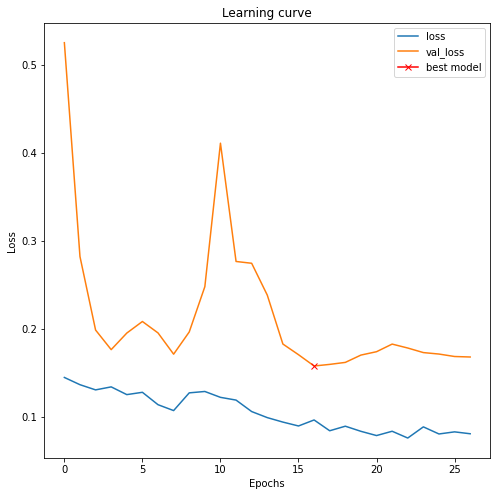

In [ ]:
# Loss curves

plt.figure(figsize=(8, 8))
plt.title("Learning curve")
plt.plot(results.history["loss"], label="loss")
plt.plot(results.history["val_loss"], label="val_loss")
plt.plot( np.argmin(results.history["val_loss"]), np.min(results.history["val_loss"]), marker="x", color="r", label="best model")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend();

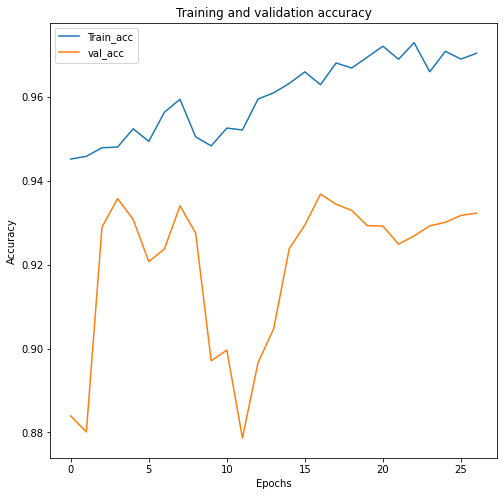

In [ ]:
# Accuracy curves

plt.figure(figsize=(8, 8))
plt.title("Accuracy curve")
plt.plot(results.history["accuracy"], label="Train_acc")
plt.plot(results.history["val_accuracy"], label="val_acc")
plt.title('Training and validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

## Inference

In [61]:
# load the best model
model.load_weights('/content/drive/MyDrive/DataScience_Test_Road_Segementation/saved_models/models/model-tgs-salt.h5_1')



In [62]:
# Predict on train, valid and test
preds_train = model.predict(X_train, verbose=1)
preds_val = model.predict(X_valid, verbose=1)
preds_test = model.predict(X_test, verbose=1)

1/1 [==============================] - 0s 30ms/step


In [63]:
# Threshold predictions
preds_train_t = (preds_train > 0.5).astype(np.uint8)
preds_val_t = (preds_val > 0.5).astype(np.uint8)
preds_test_t = (preds_test > 0.5).astype(np.uint8)

In [ ]:
# Training mean IoU
n_classes = 2
IOU_keras = MeanIoU(num_classes=n_classes)  
IOU_keras.update_state(preds_train_t, y_train)
print("Mean IoU =", IOU_keras.result().numpy())

Mean IoU = 0.78821695


In [ ]:
# Validation mean IoU
n_classes = 2
IOU_keras = MeanIoU(num_classes=n_classes)  
IOU_keras.update_state(preds_val_t, y_valid)
print("Mean IoU =", IOU_keras.result().numpy())

Mean IoU = 0.8207946


## Classification report

In [64]:
# Flattening the prediction of y_train and y_valid 
y_pred_train_flat = preds_train_t.flatten()
y_train_flat = y_train.flatten()
y_pred_valid_flat = preds_val_t.flatten()
y_valid_flat = y_valid.flatten()

In [65]:
# Trainig classifcation report
print('classification report')
print(classification_report(y_pred_train_flat, y_train_flat))
print('Accuracy')
print(accuracy_score(y_pred_train_flat, y_train_flat))
print('Area under the curve {}'.format(roc_auc_score(y_pred_train_flat, y_train_flat)))


classification report
              precision    recall  f1-score   support

           0       0.90      0.84      0.87  10439859
           1       0.98      0.99      0.98  75576141

    accuracy                           0.97  86016000
   macro avg       0.94      0.91      0.92  86016000
weighted avg       0.97      0.97      0.97  86016000

Accuracy
0.9689692847842262
Area under the curve 0.9116049330005568


In [66]:
# validation classification report

print('classification report')
print(classification_report(y_pred_valid_flat, y_valid_flat))
print('Accuracy')
print(accuracy_score(y_pred_valid_flat, y_valid_flat))
print('Area under the curve {}'.format(roc_auc_score(y_pred_valid_flat, y_valid_flat)))


classification report
              precision    recall  f1-score   support

           0       0.80      0.71      0.75   2864652
           1       0.96      0.97      0.96  18639348

    accuracy                           0.94  21504000
   macro avg       0.88      0.84      0.86  21504000
weighted avg       0.93      0.94      0.94  21504000

Accuracy
0.9368108723958334
Area under the curve 0.8389551562054613


In [68]:
# Function to plot image and prediction masks

def plot_sample(X, y, preds, ix=None):
    """Function to plot the results"""
    if ix is None:
        ix = random.randint(0, len(X))

    has_mask = y[ix].max() > 0

    fig, ax = plt.subplots(1, 3, figsize=(20, 10))
    ax[0].imshow(X[ix, ..., 0])
    if has_mask:
        ax[0].contour(y[ix].squeeze(), colors='k', levels=[0.5])
    ax[0].set_title('original')

    ax[1].imshow(y[ix].squeeze(), cmap='gray')
    ax[1].set_title('mask')

    ax[2].imshow(preds[ix].squeeze(), vmin=0, vmax=1, cmap='gray')
    
    ax[2].set_title('mask_predicted ');

   

## Predictions on training set

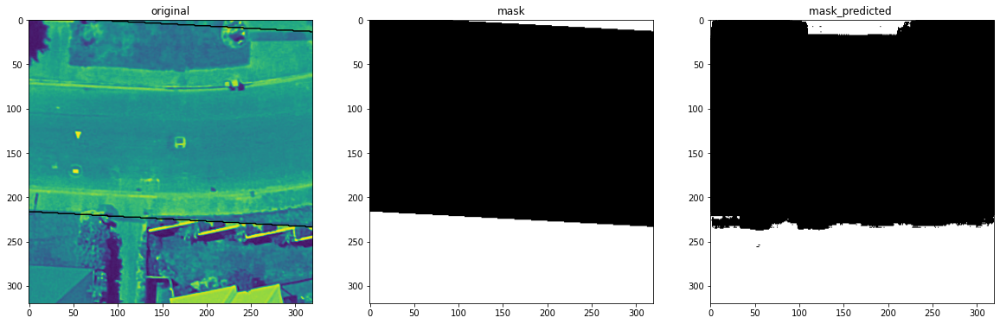

In [ ]:
# Training data 
plot_sample(X_train, y_train,  preds_train_t, ix=0)

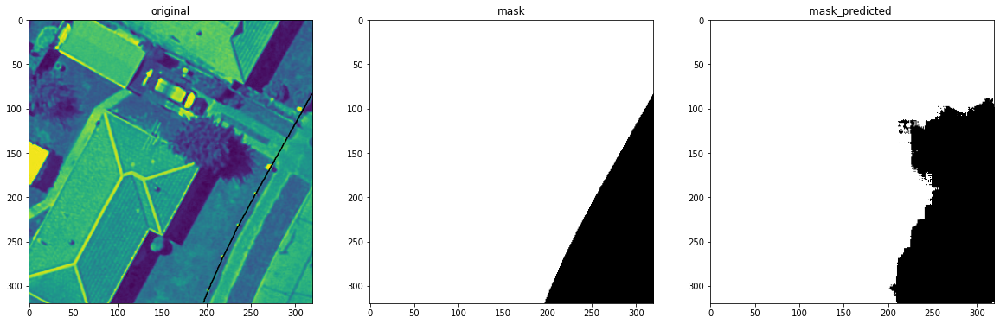

In [ ]:
plot_sample(X_train, y_train, preds_train_t, ix=79)

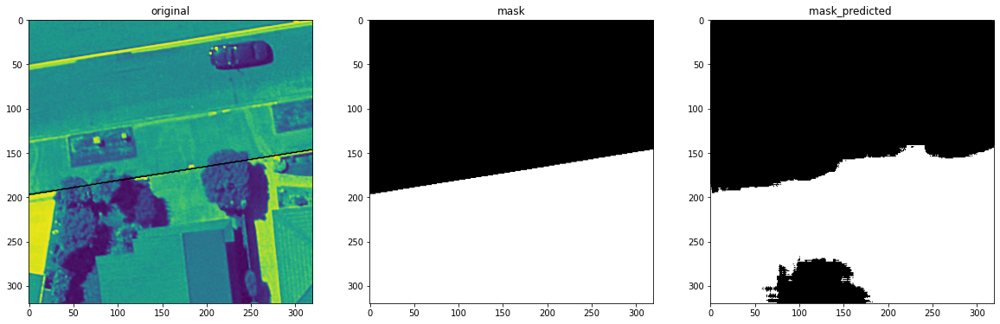

In [ ]:
plot_sample(X_train, y_train, preds_train_t, ix=100)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: UserWarning: No contour levels were found within the data range.
  del sys.path[0]


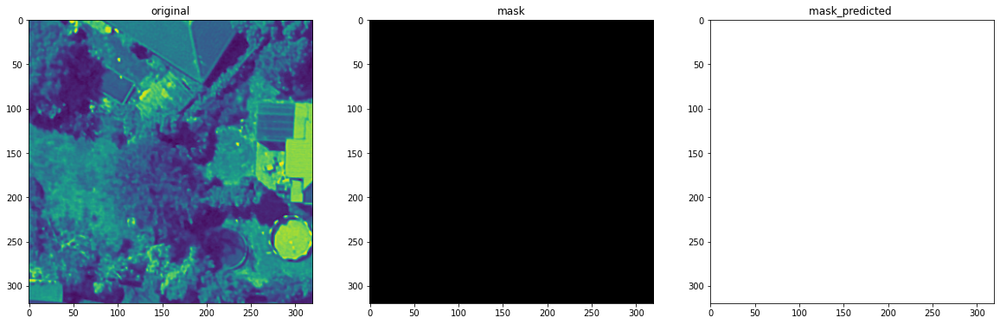

In [ ]:
plot_sample(X_train, y_train,  preds_train_t, ix=90)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: UserWarning: No contour levels were found within the data range.
  del sys.path[0]


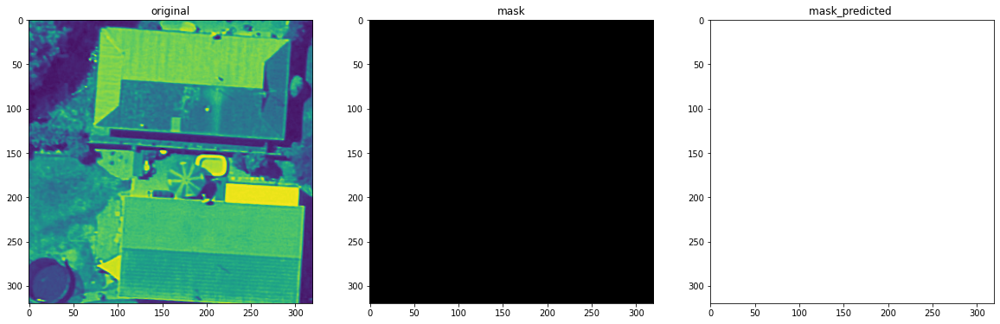

In [ ]:
plot_sample(X_train, y_train,  preds_train_t)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: UserWarning: No contour levels were found within the data range.
  del sys.path[0]


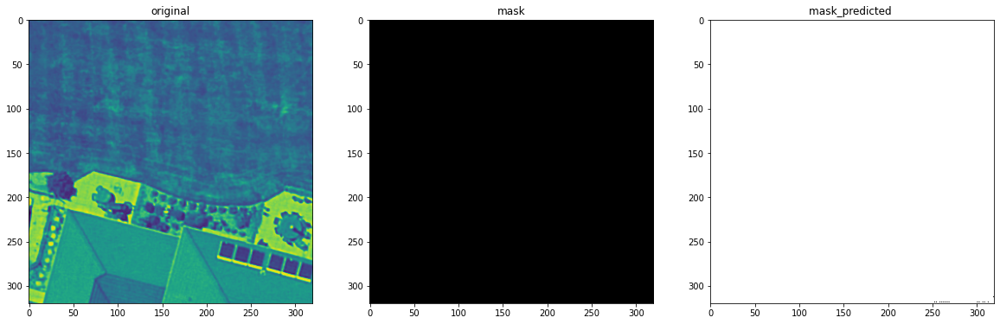

In [ ]:
plot_sample(X_train, y_train, preds_train_t)

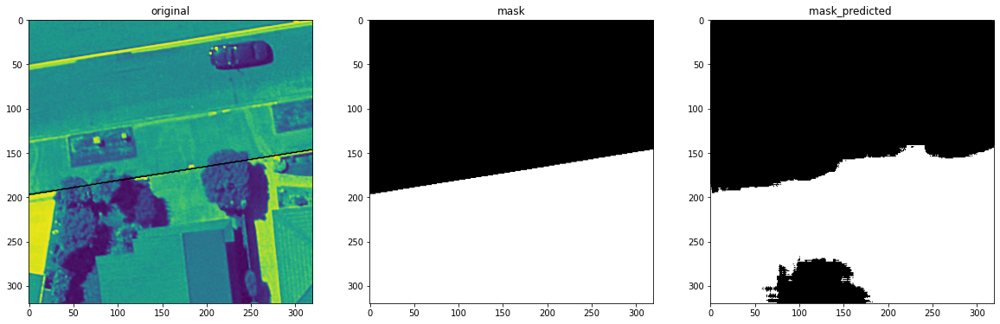

In [ ]:


plot_sample(X_train, y_train,  preds_train_t, ix= 100)



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: UserWarning: No contour levels were found within the data range.
  del sys.path[0]


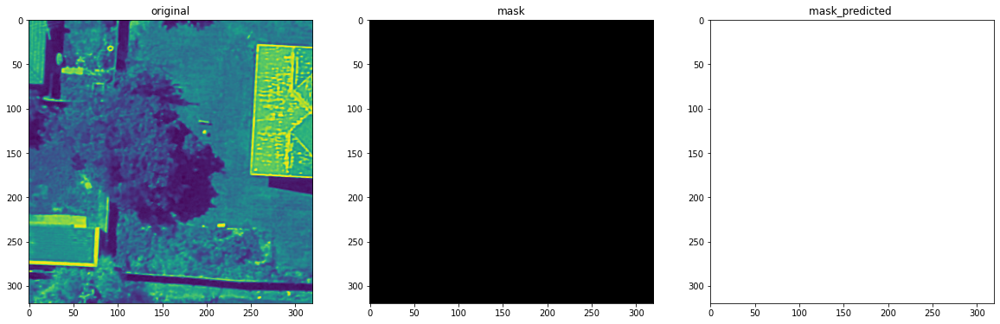

In [ ]:
plot_sample(X_train, y_train,  preds_train_t, ix=115)

## Predictions on validation set

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: UserWarning: No contour levels were found within the data range.
  del sys.path[0]


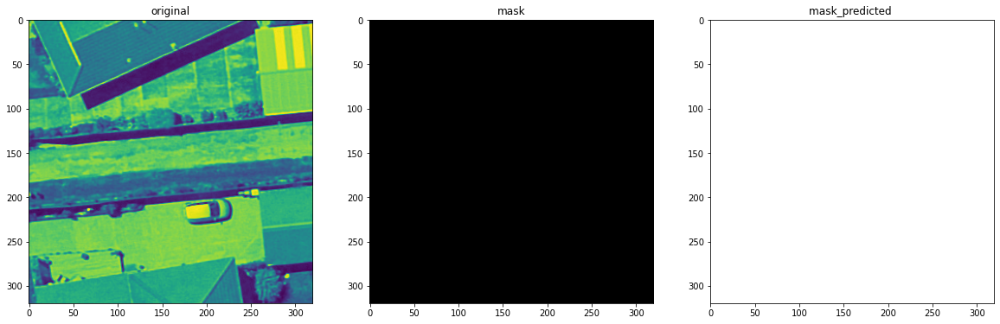

In [ ]:
# Check if valid data looks all right
plot_sample(X_valid, y_valid, preds_val_t, ix=19)

In [ ]:
plot_sample(X_valid, y_valid,  preds_val_t)

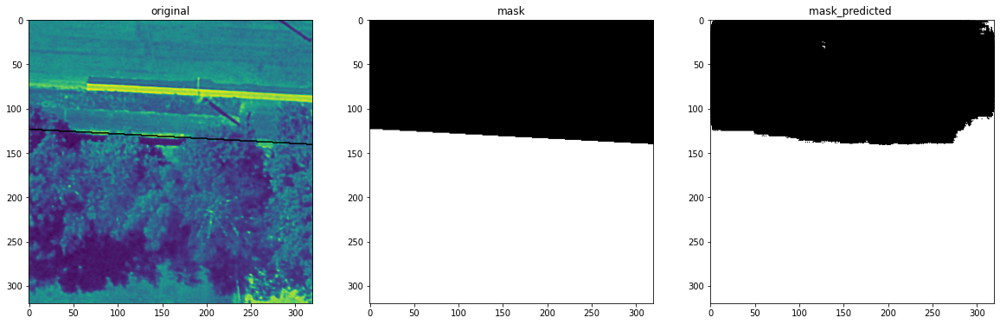

In [ ]:
plot_sample(X_valid, y_valid,  preds_val_t, ix=20)

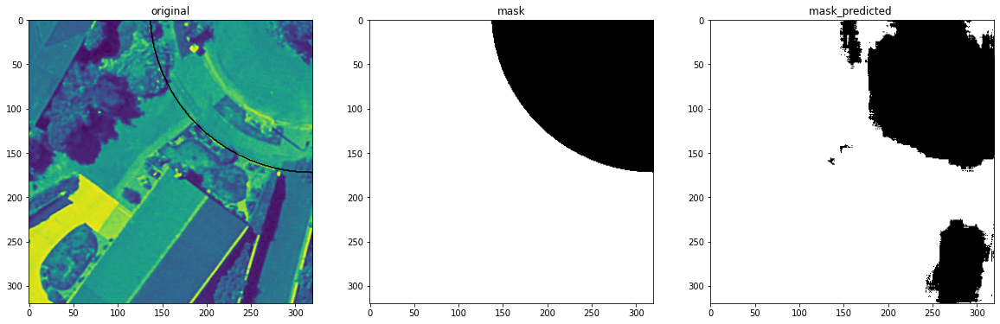

In [ ]:
plot_sample(X_valid, y_valid, preds_val_t, ix=56)

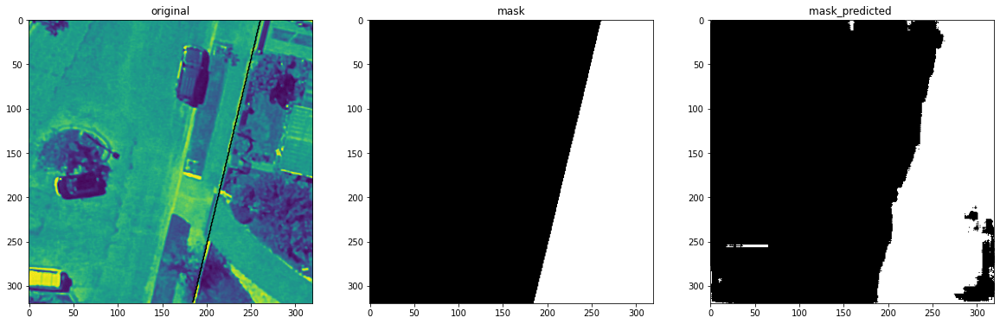

In [ ]:
plot_sample(X_valid, y_valid, preds_val_t, ix=100)

## Test prediction

Below are the test images who split into 320*320 tiles

In [ ]:
preds_test_resize = model.predict(resize_test_norm, verbose=1)

150/150 [==============================] - 1s 4ms/step


In [ ]:
preds_test_resize_t = (preds_test_resize > 0.5).astype(np.uint8)

In [ ]:
def plot_test(X, preds, ix=None):
    """Function to plot the results"""
    if ix is None:
        ix = random.randint(0, len(X))

   

    fig, ax = plt.subplots(1, 2, figsize=(8, 8))
    ax[0].imshow(X[ix, ..., 0])
    
    ax[0].set_title('original')

    ax[1].imshow(preds[ix].squeeze(), vmin=0, vmax=1, cmap='gray')
    
    ax[1].set_title('mask_predicted ');

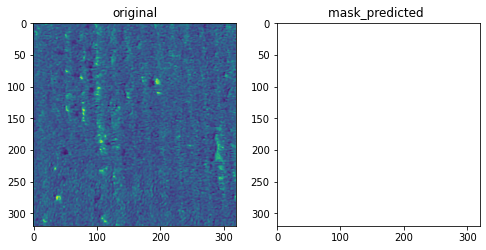

In [ ]:
# Check if training data looks all right
plot_test(resize_test_norm,  preds_test_resize_t, ix=0)

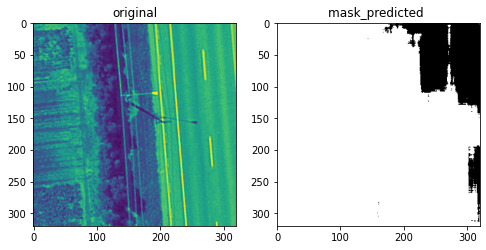

In [ ]:
# Check if training data looks all right
plot_test(resize_test_norm,  preds_test_resize_t, ix=4)

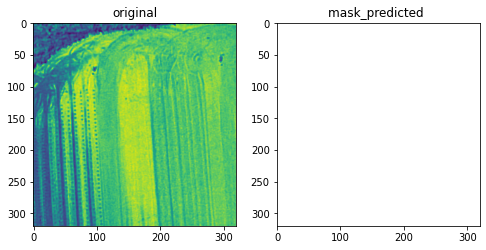

In [ ]:
# Check if training data looks all right
plot_test(resize_test_norm,  preds_test_resize_t, ix=9)

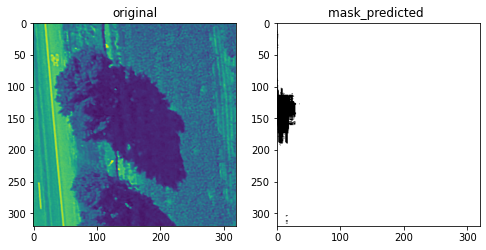

In [ ]:
# Check if training data looks all right
plot_test(resize_test_norm,  preds_test_resize_t, ix=136)

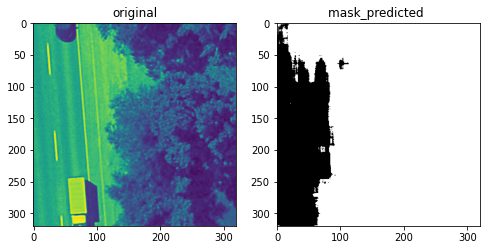

In [ ]:
# Check if training data looks all right
plot_test(resize_test_norm,  preds_test_resize_t, ix=35)

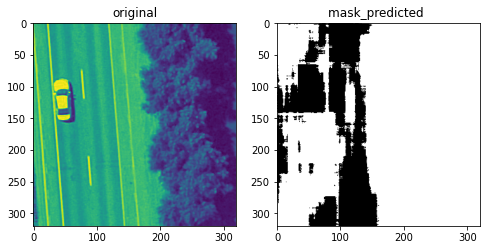

In [ ]:
# Check if training data looks all right
plot_test(resize_test_norm,  preds_test_resize_t, ix=55)

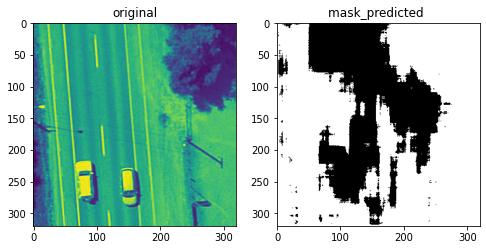

In [ ]:
# Check if training data looks all right
plot_test(resize_test_norm,  preds_test_resize_t, ix=65)

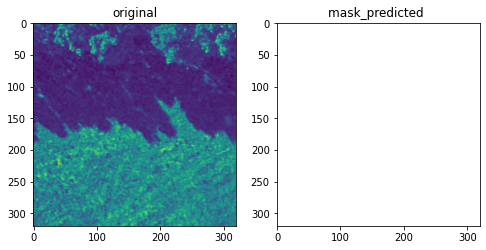

In [ ]:
# Check if training data looks all right
plot_test(resize_test_norm,  preds_test_resize_t, ix=60)

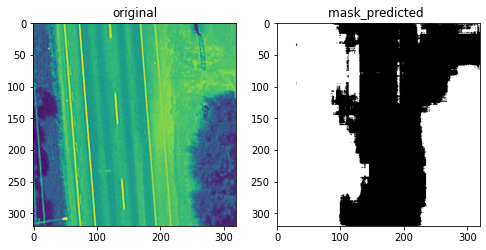

In [ ]:
# Check if training data looks all right
plot_test(resize_test_norm,  preds_test_resize_t, ix=75)

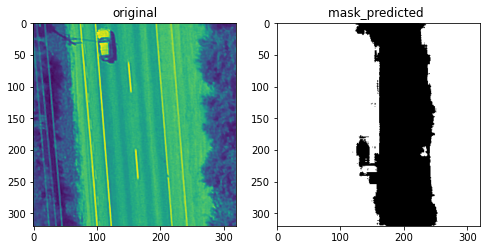

In [ ]:
# Check if training data looks all right
plot_test(resize_test_norm,  preds_test_resize_t, ix=85)

## Full size test

Below is the plot of test images who are resize into 320*320

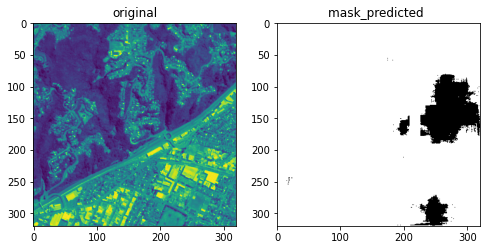

In [ ]:
# Check if training data looks all right
plot_test(X_test,  preds_test_t, ix=0)

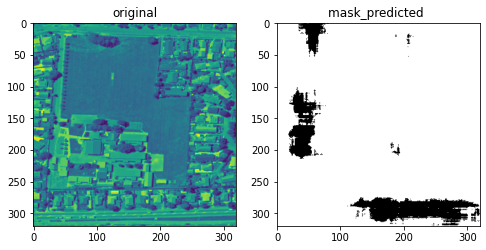

In [ ]:
# Check if training data looks all right
plot_test(X_test,  preds_test_t, ix=1)

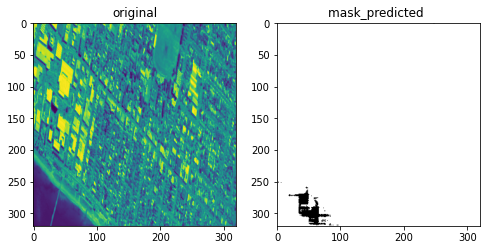

In [ ]:
# Check if training data looks all right
plot_test(X_test,  preds_test_t, ix=2)

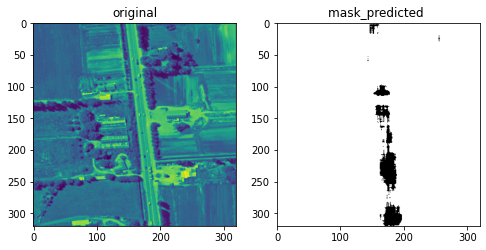

In [ ]:
# Check if training data looks all right
plot_test(X_test,  preds_test_t, ix=3)

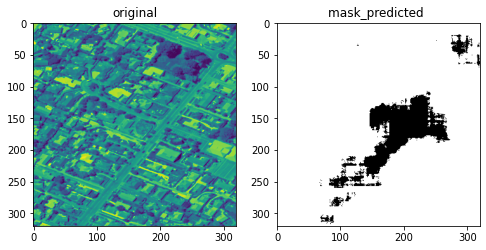

In [ ]:
# Check if training data looks all right
plot_test(X_test, preds_test_t, ix=4)

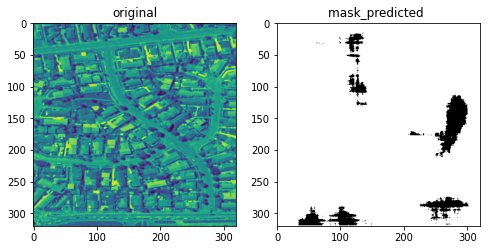

In [ ]:
# Check if training data looks all right
plot_test(X_test, preds_test_t, ix=5)

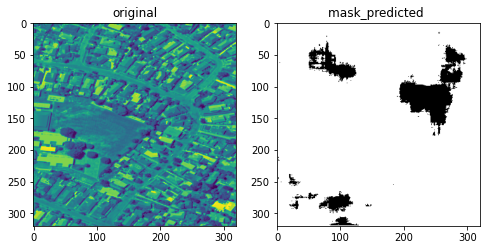

In [ ]:
# Check if training data looks all right
plot_test(X_test,  preds_test_t, ix=6)

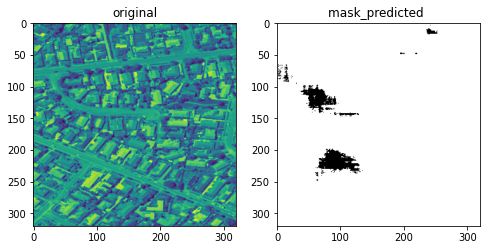

In [ ]:
# Check if training data looks all right
plot_test(X_test, preds_test_t, ix=7)

In [ ]:
preds_test_t[1].squeeze()

In [ ]:
threshold = 0.5
#test_img_number = random.randint(0, len(X_test)-1)
for i in range(len(X_test)):
    test_img = X_test[i]

    test_img_input=np.expand_dims(test_img, 0)
    #print(test_img_input.shape)
    prediction = (model.predict(test_img_input)[0,:,:, 0] > 0.5).astype(np.uint8)
    #print(prediction.shape)

    plt.figure(figsize=(16, 8))
    plt.subplot(231)
    plt.title('Testing Image')
    plt.imshow(test_img[:,:,0])

    plt.subplot(232)
    plt.title('Prediction on test image')
    plt.imshow(prediction, cmap='gray')

    plt.show()

# Mean IoU

In [ ]:
#Keras
def IoULoss(targets, inputs, smooth=1e-6):
    
    #flatten label and prediction tensors
    inputs = K.flatten(inputs)
    targets = K.flatten(targets)
    
    intersection = K.sum(K.dot(targets, inputs))
    total = K.sum(targets) + K.sum(inputs)
    union = total - intersection
    
    IoU = (intersection + smooth) / (union + smooth)
    return 1 - IoU

In [ ]:
def dice_coeff(y_true, y_pred):
    smooth = 1.
    # Flatten
    y_true_f = tf.reshape(y_true, [-1])
    y_pred_f = tf.reshape(y_pred, [-1])
    intersection = tf.reduce_sum(y_true_f * y_pred_f)
    score = (2. * intersection + smooth) / (tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) + smooth)
    return score

In [ ]:
def dice_loss(y_true, y_pred):
    loss = 1 - dice_coeff(y_true, y_pred)
    return loss

In [ ]:
from keras.losses import binary_crossentropy

def bce_dice_loss(y_true, y_pred):
    loss = binary_crossentropy(y_true, y_pred) + dice_loss(y_true, y_pred)
    return loss

In [ ]:
model_1 = get_unet(input_img, n_filters=16, dropout=0.05, batchnorm=True)

In [ ]:
model_1.compile(optimizer='adam', loss=bce_dice_loss, metrics=[dice_loss])

model_1.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
img (InputLayer)                (None, 320, 320, 3)  0                                            
__________________________________________________________________________________________________
conv2d_21 (Conv2D)              (None, 320, 320, 16) 448         img[0][0]                        
__________________________________________________________________________________________________
batch_normalization_20 (BatchNo (None, 320, 320, 16) 64          conv2d_21[0][0]                  
__________________________________________________________________________________________________
activation_20 (Activation)      (None, 320, 320, 16) 0           batch_normalization_20[0][0]     
____________________________________________________________________________________________

In [ ]:


callbacks_1 = [
    EarlyStopping(patience=10, verbose=1),
    ReduceLROnPlateau(factor=0.1, patience=5, min_lr=0.00001, verbose=1),
    ModelCheckpoint('/content/drive/MyDrive/DataScience_Test_Road_Segementation/saved_models/models/custom_loss.h5', verbose=1, save_best_only=True, save_weights_only=True)
]



In [ ]:
history = model_1.fit(train_dataset,
                      batch_size=32,
                   epochs=50,
                   validation_data=(X_valid,y_valid),
                   callbacks=callbacks_1)

In [ ]:
results = model_1.fit(X_train, y_train, batch_size=32, epochs=50, callbacks=cp,\
                    validation_data=(X_valid, y_valid))

In [ ]:
import keras.backend as K

#Keras
def DiceLoss(targets, inputs, smooth=1e-6):
    
    #flatten label and prediction tensors
    inputs = K.flatten(inputs)
    targets = K.flatten(targets)
    
    intersection = K.sum(K.dot(targets, inputs))
    dice = (2*intersection + smooth) / (K.sum(targets) + K.sum(inputs) + smooth)
    return 1 - dice

In [ ]:
from segmentation_models import Unet
from segmentation_models import get_preprocessing
from segmentation_models.losses import bce_jaccard_loss
from segmentation_models.metrics import iou_score

BACKBONE = 'resnet34'
preprocess_input = get_preprocessing(BACKBONE)

# load your data
#x_train, y_train, x_val, y_val = load_data(...)

# preprocess input
x_train = preprocess_input(X_train)
x_val = preprocess_input(X_valid)

# define model
model = Unet(BACKBONE, encoder_weights='imagenet')
model.compile('Adam', loss=bce_jaccard_loss, metrics=[iou_score])

# fit model
model.fit(
    x=x_train,
    y=y_train,
    batch_size=16,
    epochs=100,
    validation_data=(x_val, y_valid),
)